In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
from glob import glob
%matplotlib inline
import matplotlib.pyplot as plt
#import seaborn as sns

##Import any other packages you may need here
from itertools import chain

import skimage
from skimage import io

import sklearn
from scipy.ndimage import gaussian_filter

from random import sample

EDA is open-ended, and it is up to you to decide how to look at different ways to slice and dice your data. A good starting point is to look at the requirements for the FDA documentation in the final part of this project to guide (some) of the analyses you do. 

This EDA should also help to inform you of how pneumonia looks in the wild. E.g. what other types of diseases it's commonly found with, how often it is found, what ages it affects, etc. 

Note that this NIH dataset was not specifically acquired for pneumonia. So, while this is a representation of 'pneumonia in the wild,' the prevalence of pneumonia may be different if you were to take only chest x-rays that were acquired in an ER setting with suspicion of pneumonia. 

Perform the following EDA:
* The patient demographic data such as gender, age, patient position,etc. (as it is available)
* The x-ray views taken (i.e. view position)
* The number of cases including: 
    * number of pneumonia cases,
    * number of non-pneumonia cases
* The distribution of other diseases that are comorbid with pneumonia
* Number of disease per patient 
* Pixel-level assessments of the imaging data for healthy & disease states of interest (e.g. histograms of intensity values) and compare distributions across diseases.

Note: use full NIH data to perform the first a few EDA items and use `sample_labels.csv` for the pixel-level assassements. 

Also, **describe your findings and how will you set up the model training based on the findings.**

In [3]:
## Below is some helper code to read data for you.
## Load NIH data
all_xray_df = pd.read_csv('/data/Data_Entry_2017.csv')
all_image_paths = {os.path.basename(x): x for x in 
                   glob(os.path.join('/data','images*', '*', '*.png'))}
print('Scans found:', len(all_image_paths), ', Total Headers', all_xray_df.shape[0])
all_xray_df['path'] = all_xray_df['Image Index'].map(all_image_paths.get)
all_xray_df.sample(3)

## Load 'sample_labels.csv' data for pixel level assessments
sample_df = pd.read_csv('sample_labels.csv')
sample_df['path'] = sample_df['Image Index'].map(all_image_paths.get)
sample_df.sample(3)

Scans found: 112120 , Total Headers 112120


,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImageWidth,OriginalImageHeight,OriginalImagePixelSpacing_x,OriginalImagePixelSpacing_y,path
2705,00013616_027.png,Infiltration,27,13616,063Y,M,AP,2500,2048,0.168,0.168,/data/images_006/images/00013616_027.png
3228,00015924_000.png,No Finding,0,15924,038Y,M,PA,2986,2991,0.143,0.143,/data/images_007/images/00015924_000.png
597,00003076_000.png,No Finding,0,3076,033Y,M,PA,2048,2500,0.168,0.168,/data/images_002/images/00003076_000.png


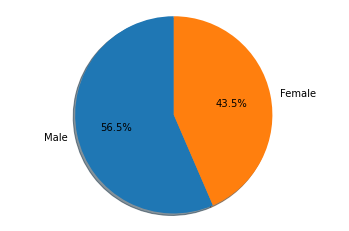

In [4]:
## EDA
#plt.figure()
#all_xray_df['Patient Gender'].value_counts().plot(kind = 'pie', subplots=True)


labels = 'Male', 'Female'
sizes = all_xray_df['Patient Gender'].value_counts()
# only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

Text(0, 0.5, 'Frequency')

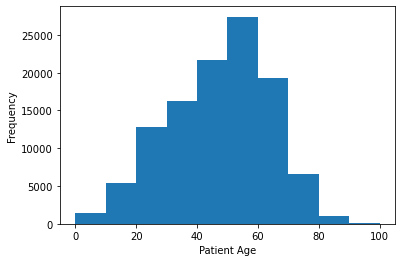

In [5]:
plt.figure()
plt.hist(all_xray_df['Patient Age'], bins = [i * 10 for i in range(11)])

plt.xlabel("Patient Age")
plt.ylabel("Frequency")

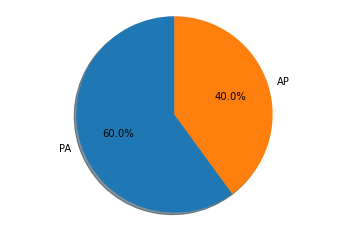

In [6]:
#plt.figure()
#all_xray_df['View Position'].value_counts().plot(kind = 'bar')

labels = 'PA', 'AP'
sizes = all_xray_df['View Position'].value_counts()
# only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

In [7]:
all_diseases = np.unique(list(chain(*all_xray_df['Finding Labels'].map(lambda all_findings: all_findings.split('|')).tolist())))
all_diseases = [x for x in all_diseases if len(x)>0]
print('All Labels ({}): {}'.format(len(all_diseases), all_diseases))

for c_disease in all_diseases:
    if len(c_disease)>1: # leave out empty labels
        all_xray_df[c_disease] = all_xray_df['Finding Labels'].map(lambda finding: 1.0 if c_disease in finding else 0)
all_xray_df.sample(3)

All Labels (15): ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'No Finding', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,...,Emphysema,Fibrosis,Hernia,Infiltration,Mass,No Finding,Nodule,Pleural_Thickening,Pneumonia,Pneumothorax
7466,00001959_000.png,Cardiomegaly,0,1959,50,F,PA,2048,2500,0.168,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
65289,00016122_002.png,No Finding,2,16122,50,F,AP,2500,2048,0.168,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
67032,00016568_033.png,Edema|Fibrosis|Infiltration|Mass|Nodule,33,16568,39,F,PA,2048,2500,0.168,...,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0


In [8]:
#all_xray_df[all_diseases].sum()/len(all_xray_df)
all_xray_df[all_diseases].sum()

Atelectasis           11559.0
Cardiomegaly           2776.0
Consolidation          4667.0
Edema                  2303.0
Effusion              13317.0
Emphysema              2516.0
Fibrosis               1686.0
Hernia                  227.0
Infiltration          19894.0
Mass                   5782.0
No Finding            60361.0
Nodule                 6331.0
Pleural_Thickening     3385.0
Pneumonia              1431.0
Pneumothorax           5302.0
dtype: float64

In [9]:
print('Total number of diseases: ' + str(len(all_xray_df)))

Total number of diseases: 112120


Text(0, 0.5, 'Frequency')

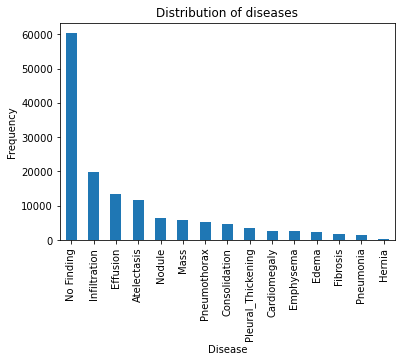

In [10]:
plt.figure()
all_xray_df[all_diseases].sum().sort_values(ascending=False).plot(kind='bar')
plt.title("Distribution of diseases")
plt.xlabel("Disease")
plt.ylabel("Frequency")


Text(0, 0.5, 'Frequency')

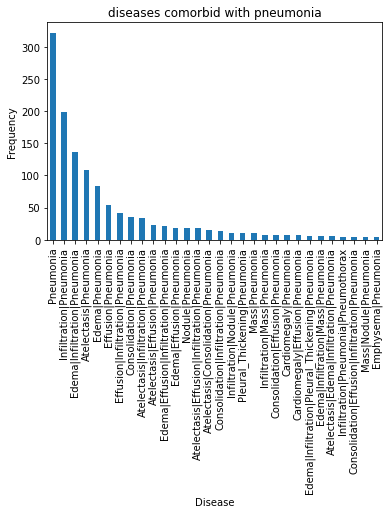

In [11]:
plt.figure()
all_xray_df[all_xray_df.Pneumonia == 1]['Finding Labels'].value_counts()[0:30].plot(kind='bar')

plt.title("diseases comorbid with pneumonia")
plt.xlabel("Disease")
plt.ylabel("Frequency")

Text(0.5, 1.0, 'Age distribution for pneumonia cases')

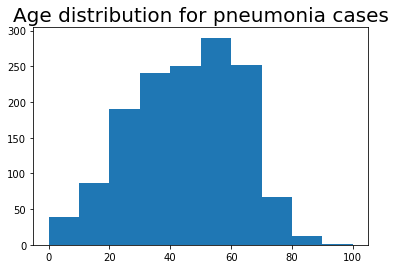

In [12]:
plt.figure()
plt.hist(all_xray_df[all_xray_df.Pneumonia == 1]['Patient Age'].values, bins = [i * 10 for i in range(11)])
plt.title('Age distribution for pneumonia cases', fontsize=20)

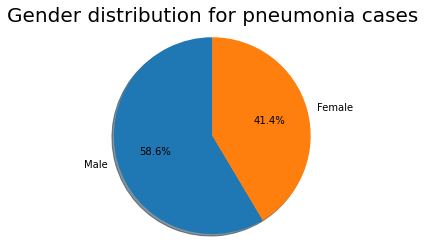

In [13]:
labels = 'Male', 'Female'
sizes = all_xray_df[all_xray_df.Pneumonia == 1]['Patient Gender'].value_counts()
# only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Gender distribution for pneumonia cases', fontsize=20)
plt.show()

Looking at both the gender and age diagrams, the demographics of people with pneumonia is very similar to the demographics of all people tested. That is, there is no bias toward either or age groups.

In [14]:
all_diseases.remove('No Finding')
all_xray_df[all_diseases].sum().sum() / len(all_xray_df)

0.7240099892971816

In [15]:
all_diseases = np.unique(list(chain(*all_xray_df['Finding Labels'].map(lambda all_findings: all_findings.split('|')).tolist())))
all_diseases = [x for x in all_diseases if len(x)>0]
print('All Labels ({}): {}'.format(len(all_diseases), all_diseases))

for c_disease in all_diseases:
    if len(c_disease)>1: # leave out empty labels
        sample_df[c_disease] = sample_df['Finding Labels'].map(lambda finding: 1.0 if c_disease in finding else 0)

sample_df.sample(3)

All Labels (15): ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'No Finding', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImageWidth,OriginalImageHeight,OriginalImagePixelSpacing_x,...,Emphysema,Fibrosis,Hernia,Infiltration,Mass,No Finding,Nodule,Pleural_Thickening,Pneumonia,Pneumothorax
5442,00029579_006.png,Nodule,6,29579,024Y,F,AP,3056,2544,0.139,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
424,00002278_000.png,Cardiomegaly|Effusion,0,2278,063Y,F,PA,2892,2898,0.143,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3407,00016787_003.png,No Finding,3,16787,051Y,M,AP,2500,2048,0.168,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


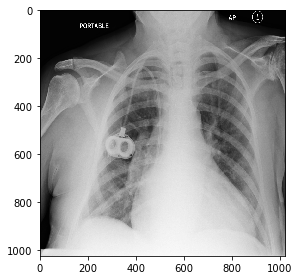

In [16]:
pneumonia_path = sample_df[sample_df.Pneumonia == 1]['path'].iloc[0]
pneumonia_image = io.imread(pneumonia_path)
io.imshow(pneumonia_image)

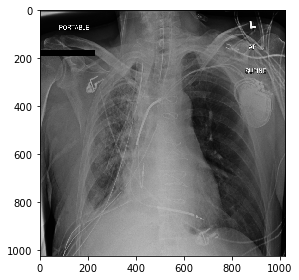

In [17]:
no_pneumonia_path = sample_df[sample_df.Pneumonia == 0]['path'].iloc[0]
no_pneumonia_image = io.imread(no_pneumonia_path)
io.imshow(no_pneumonia_image)

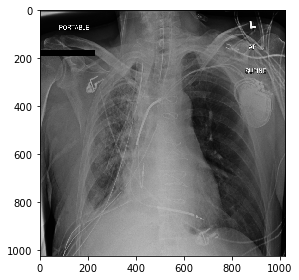

In [18]:
infiltration_path = sample_df[sample_df.Infiltration == 1]['path'].iloc[0]
infiltration_image = io.imread(infiltration_path)
io.imshow(infiltration_image)

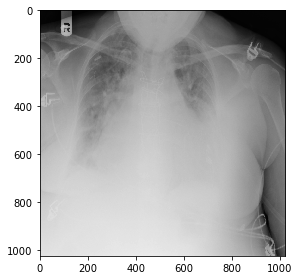

In [19]:
Effusion_path = sample_df[sample_df.Effusion == 1]['path'].iloc[0]
Effusion_image = io.imread(Effusion_path)
io.imshow(Effusion_image)

In [20]:
thresh = 50

pneumonia_bin = (pneumonia_image > thresh) * 255
no_pneumonia_bin = (no_pneumonia_image > thresh) * 255
infiltration_bin = (infiltration_image > thresh) * 255
Effusion_bin = (Effusion_image > thresh) * 255

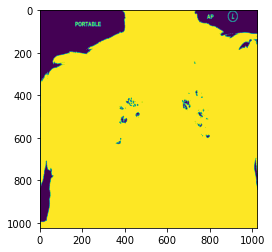

In [21]:
plt.imshow(pneumonia_bin)

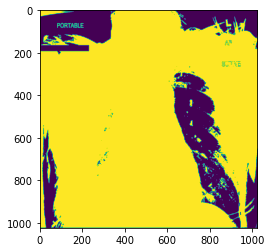

In [22]:
plt.imshow(no_pneumonia_bin)

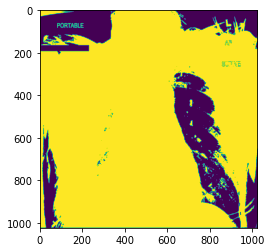

In [23]:
plt.imshow(infiltration_bin)

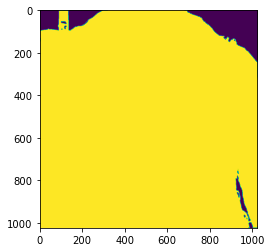

In [24]:
plt.imshow(Effusion_bin)

In [25]:
sample_images = []
disease_names = []

NUMBER_OF_IMAGES_PER_DISEASE = 4

for disease in all_diseases:
    images_with_disease = sample(sample_df[sample_df[disease] == 1].path.tolist(), NUMBER_OF_IMAGES_PER_DISEASE)
    sample_images.extend(images_with_disease)
    disease_names.extend([disease] * NUMBER_OF_IMAGES_PER_DISEASE)

index = 1

plt.figure(figsize = (128, 128))

for image, disease in zip(sample_images, disease_names):
    plt.subplot(len(all_diseases), NUMBER_OF_IMAGES_PER_DISEASE, index)
    index += 1
    img = io.imread(image)
    img_mask = (img > thresh)
    img = img[img_mask]
    img_mask = (img < 250)
    data = plt.hist(img[img_mask].tolist(), bins=256, color='red')
    plt.title(disease, fontsize=50)
    



Looking at these individual intensity plots, it is difficult to draw any conclusions. Even within each disease, the plots vary widely. In order to get a better understanding, then, we plot the average intensity distribution over 10 images for each disease a few code cells below.

In [26]:
sample_images = []
disease_names = []

NUMBER_OF_IMAGES_PER_DISEASE = 4

for disease in all_diseases:
    images_with_disease = sample(sample_df[sample_df[disease] == 1].path.tolist(), NUMBER_OF_IMAGES_PER_DISEASE)
    sample_images.extend(images_with_disease)
    disease_names.extend([disease] * NUMBER_OF_IMAGES_PER_DISEASE)

n = 1
plt.figure(figsize = (128, 128))
for image, disease in zip(sample_images, disease_names):
    plt.subplot(len(all_diseases), NUMBER_OF_IMAGES_PER_DISEASE, n)
   
    n += 1
    img = io.imread(image)
    data = plt.imshow(img, cmap = 'gray', aspect='auto')
    plt.title(disease, fontsize=50)

In [31]:
index = 1

plt.figure(figsize = (128, 128))

for disease in all_diseases:
    plt.subplot(len(all_diseases) / 3, 3, index)
    
    index += 1
    
    intensities = []
    
    NUMBER_OF_IMAGES_TO_GET_AVERAGE = 10
    
    disease_images = sample(sample_df[sample_df[disease] == 1].path.tolist(), NUMBER_OF_IMAGES_TO_GET_AVERAGE)
    
    for image in disease_images:
        img = io.imread(image)
        img_mask = (img > thresh)
        img = img[img_mask]
        img_mask = (img < 250)
        
        single_intensity = np.array(img[img_mask].tolist())
        average = np.mean(single_intensity)
        std = np.std(single_intensity)
        
        intensities.extend((single_intensity - average) / std)
    
    data = plt.hist(intensities, bins=256, color='red')
    plt.title(disease, fontsize = 50)

Looking at these intensity distributions, it seems clear that the pneumonia intensity plot has the following characteristics: (1) low values to start, (2) a rapid increase afterwards, (3) a flat period close to the maximum value, and (4) a rapid decline to 0 immediately afterwards. From the intensity plots of other diseases, however, it is apparent that only a few show the same characteristics: (1) infiltration, (2) mass, (3) no finding, and (4) pleural thickening. Further, we know that in the presence of any of the other diseases, our model tends to overpredict the presence of pneumonia - in this scenario, our validation data showed a sensitivity of 1 (all cases with pneumonia were correctly identified), but a specificity of 0 (a number of false positives were found as well).

Given this information, it should be possible to improve the efficacy of the model in two ways: (1) if the intensity distribution for the patient does not match the intensity distribution for pneumonia, then we can avoid running the model altogether (the patient has another disease, and our model currently always overpredicts the presence of pneumonia if another disease is present), and (2) if we know, a priori, that the patient has one of the three diseases that has a similar intensity profile, then we can avoid running the model altogether (as before, we know the model is likely to predict a "has pneumonia" in this situation).